In [5]:
import cv2
import os
import numpy as np
import cv2
import numpy as np
from IPython.display import display, Video, Image

In [2]:
from ultralytics import YOLO
model= YOLO("yolov8x.pt") 

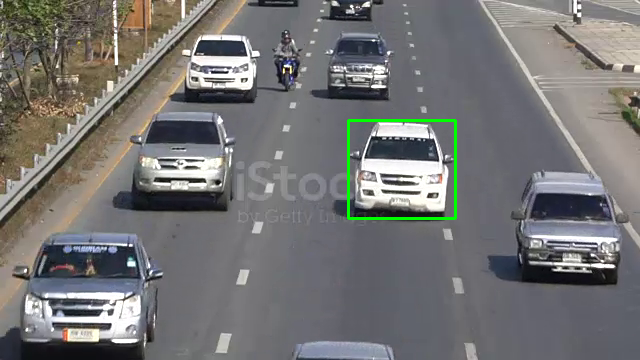

KeyboardInterrupt: 

In [17]:
import cv2
import numpy as np
from IPython.display import display, clear_output
from PIL import Image

# Initialize the video capture
camera = cv2.VideoCapture("video.mp4")

font = cv2.FONT_HERSHEY_SIMPLEX

# Define the regions
region1 = np.array([(180, 0), (320, 0), (210, 360), (-70, 360)]).reshape((-1, 1, 2))
region2 = np.array([(320, 0), (405, 0), (470, 360), (210, 360)]).reshape((-1, 1, 2))
region3 = np.array([(405, 0), (500, 0), (690, 360), (470, 360)]).reshape((-1, 1, 2))

# Initialize sets for tracking
left_region = set()
middle_region = set()
right_region = set()

# Video processing loop
while True:
    ret, frame = camera.read()
    if not ret:
        break

    # Simulate the object tracking results (replace `model.track` with actual model logic)
    rgb_img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = model.track(rgb_img, persist=True, verbose=False)
    labels = results[0].names

    for i in range(len(results[0].boxes)):
        x1, y1, x2, y2 = results[0].boxes.xyxy[i]
        score = results[0].boxes.conf[i]
        cls = results[0].boxes.cls[i]
        ids = results[0].boxes.id[i]
        x1, y1, x2, y2, score, cls, ids = (
            int(x1), int(y1), int(x2), int(y2), float(score), int(cls), int(ids)
        )

        name = labels[cls]
        if score < 0.1 or name not in ["car", "truck", "motorcycle", "bicycle"]:
            continue

        # Calculate the center of the bounding box
        cx = int(x1 / 2 + x2 / 2)
        cy = int(y1 / 2 + y2 / 2)

        # Check which region the object is in
        inside_region1 = cv2.pointPolygonTest(region1, (cx, cy), False)
        inside_region2 = cv2.pointPolygonTest(region2, (cx, cy), False)
        inside_region3 = cv2.pointPolygonTest(region3, (cx, cy), False)

        # Update region sets and draw bounding boxes if conditions are met
        if inside_region1 > 0:
            left_region.add(ids)
            if ids in middle_region or ids in right_region:
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

        if inside_region2 > 0:
            middle_region.add(ids)
            if ids in left_region or ids in right_region:
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

        if inside_region3 > 0:
            right_region.add(ids)
            if ids in middle_region or ids in left_region:
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # Convert the frame to RGB for displaying in the notebook
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    img_pil = Image.fromarray(rgb_frame)

    # Clear previous frame and display the current one
    clear_output(wait=True)
    display(img_pil)

# Release resources
camera.release()
cv2.destroyAllWindows()
